In [4]:
##importing of libraries 
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras.optimizers.legacy import Adam as AdamLegacy
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from sklearn.metrics import classification_report

# Function to preprocess the images
def preprocess_images(image_paths, target_size=(224, 224)):
    preprocessed_images = []
    for path in image_paths:
        img = cv2.imread(path)
        img = cv2.resize(img, target_size)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = img.astype('float32') / 255.0
        preprocessed_images.append(img)
    if preprocessed_images:
        preprocessed_images = np.array(preprocessed_images)
    return preprocessed_images

# Function to fetch all .jpg images from subfolders and their labels
def fetch_jpgs_and_labels_from_subfolders(parent_directory):
    jpg_files = []
    labels = []
    for root, dirs, files in os.walk(parent_directory):
        label = os.path.basename(root)
        for file in files:
            if file.lower().endswith('.jpg'):
                jpg_path = os.path.join(root, file)
                jpg_files.append(jpg_path)
                labels.append(label)
    return jpg_files, labels

##remember to use own path 
# Parent directory containing subfolders with images -- please use your own path by copying the path from the left column--
parent_directory = '/Users/elizabethamponsah/Documents/CSY3025  Artificial intelligence/CSY3025 AS2/food101 tiny'

# Fetch all .jpg images from subfolders and their labels
image_paths, labels = fetch_jpgs_and_labels_from_subfolders(parent_directory)
print("Number of images fetched:", len(image_paths))

# Encode the labels
label_encoder = LabelEncoder()
encoded_labels = label_encoder.fit_transform(labels)
categorical_labels = to_categorical(encoded_labels)

# Preprocess the images
preprocessed_images = preprocess_images(image_paths)
print("Number of preprocessed images:", len(preprocessed_images))

# Check if there are any preprocessed images
if len(preprocessed_images) == 0:
    print("No preprocessed images found.")
else:
    # Split the dataset into training, validation, and testing sets
    X_train, X_test, y_train, y_test = train_test_split(preprocessed_images, categorical_labels, test_size=0.2, random_state=42)
    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=42)  # 0.25 * 0.8 = 0.2

    print(f"Training set size: {len(X_train)}")
    print(f"Validation set size: {len(X_val)}")
    print(f"Testing set size: {len(X_test)}")

    # Data augmentation
    datagen = ImageDataGenerator(
        rotation_range=30,
        width_shift_range=0.2,
        height_shift_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )
    datagen.fit(X_train)

    # Load the pre-trained DenseNet121 model
    base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

    # Freeze most layers of the pre-trained model
    for layer in base_model.layers[:-30]:  # Fine tune the last 30 layers 
        layer.trainable = False

    # Create a new model to add on top of base model
    model = Sequential()
    model.add(base_model)
    model.add(GlobalAveragePooling2D())
    model.add(Dense(512, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(len(label_encoder.classes_), activation='softmax'))

    # Compile the model
    model.compile(optimizer=AdamLegacy(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

    # Set up early stopping and learning rate reduction to reduce overfitting 
    early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=0.00001)

    # Train the model
    history = model.fit(datagen.flow(X_train, y_train, batch_size=32), 
                        validation_data=(X_val, y_val), 
                        epochs=15, 
                        callbacks=[early_stopping, reduce_lr])

    # Evaluate the model on the test set
    test_loss, test_accuracy = model.evaluate(X_test, y_test)
    print("Test Loss:", test_loss)
    print("Test Accuracy:", test_accuracy)

    # Predict the test set
    y_pred = model.predict(X_test)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true_classes = np.argmax(y_test, axis=1)

    # Print classification report
    report = classification_report(y_true_classes, y_pred_classes, target_names=label_encoder.classes_)
    print("\nClassification Report:")
    print(report)


Number of images fetched: 1500
Number of preprocessed images: 1500
Training set size: 900
Validation set size: 300
Testing set size: 300
Epoch 1/15
29/29 [==============================] - 74s 2s/step - loss: 2.5170 - accuracy: 0.1533 - val_loss: 1.9222 - val_accuracy: 0.3233 - lr: 1.0000e-04
Epoch 2/15
29/29 [==============================] - 69s 2s/step - loss: 2.0084 - accuracy: 0.2856 - val_loss: 1.5520 - val_accuracy: 0.5233 - lr: 1.0000e-04
Epoch 3/15
29/29 [==============================] - 70s 2s/step - loss: 1.7215 - accuracy: 0.4278 - val_loss: 1.2932 - val_accuracy: 0.6467 - lr: 1.0000e-04
Epoch 4/15
29/29 [==============================] - 68s 2s/step - loss: 1.4407 - accuracy: 0.5211 - val_loss: 1.1109 - val_accuracy: 0.6967 - lr: 1.0000e-04
Epoch 5/15
29/29 [==============================] - 70s 2s/step - loss: 1.3130 - accuracy: 0.5689 - val_loss: 0.9845 - val_accuracy: 0.7367 - lr: 1.0000e-04
Epoch 6/15
29/29 [==============================] - 69s 2s/step - loss: 1.1335

Class: apple_pie
Number of images: 24


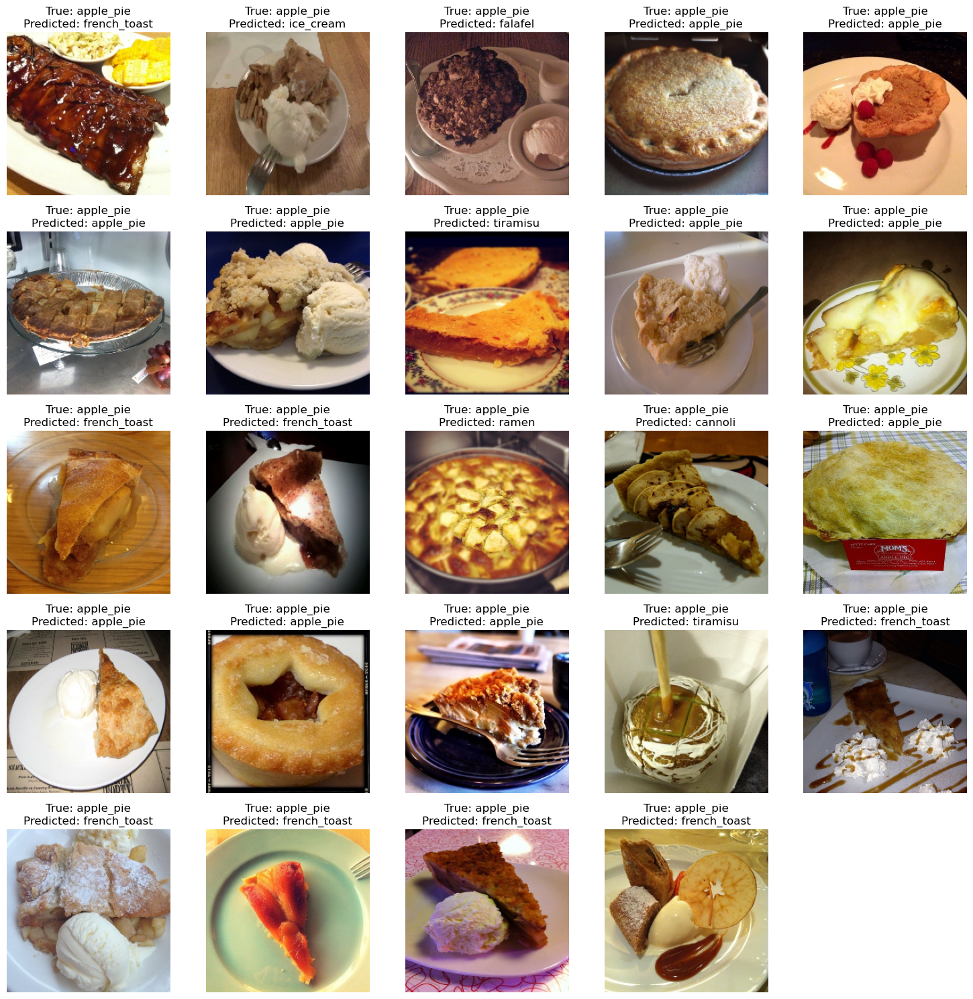

Class: bibimbap
Number of images: 38


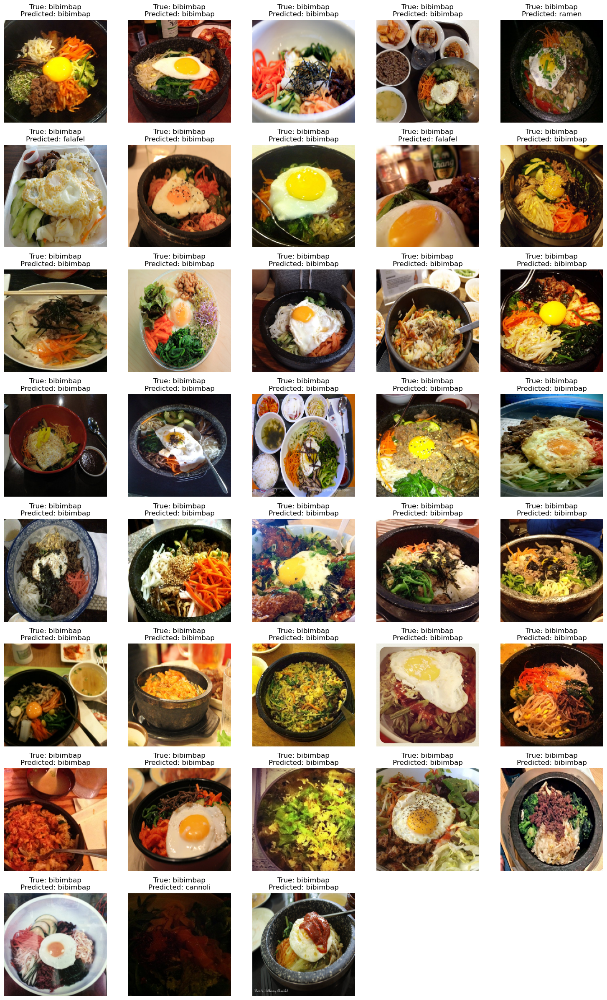

Class: cannoli
Number of images: 28


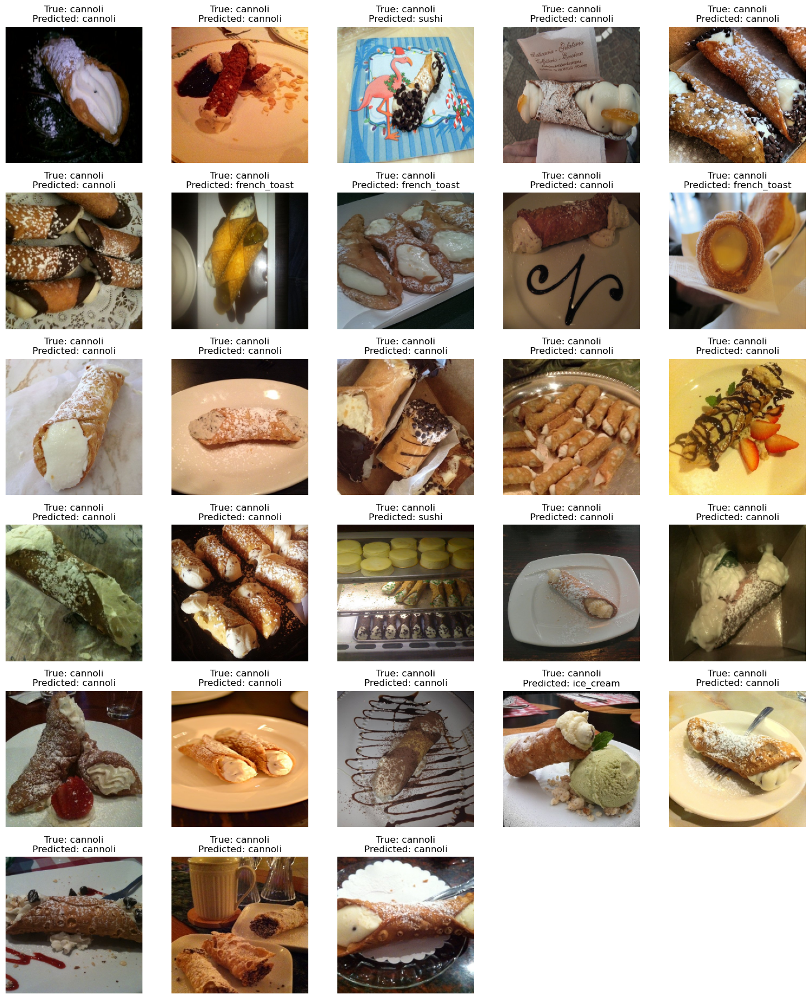

Class: edamame
Number of images: 31


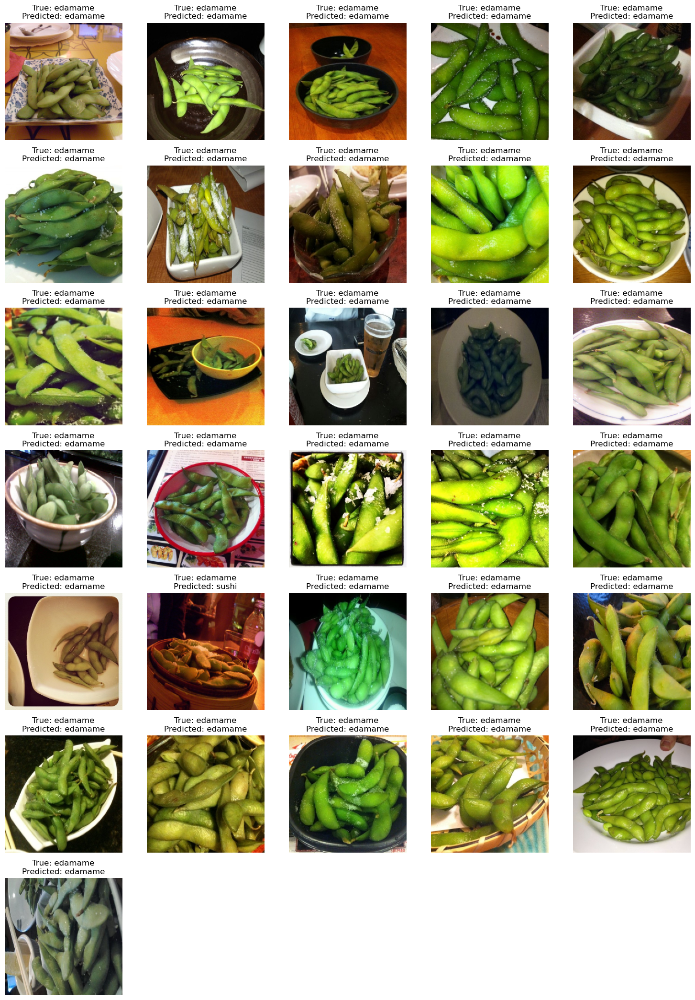

Class: falafel
Number of images: 34


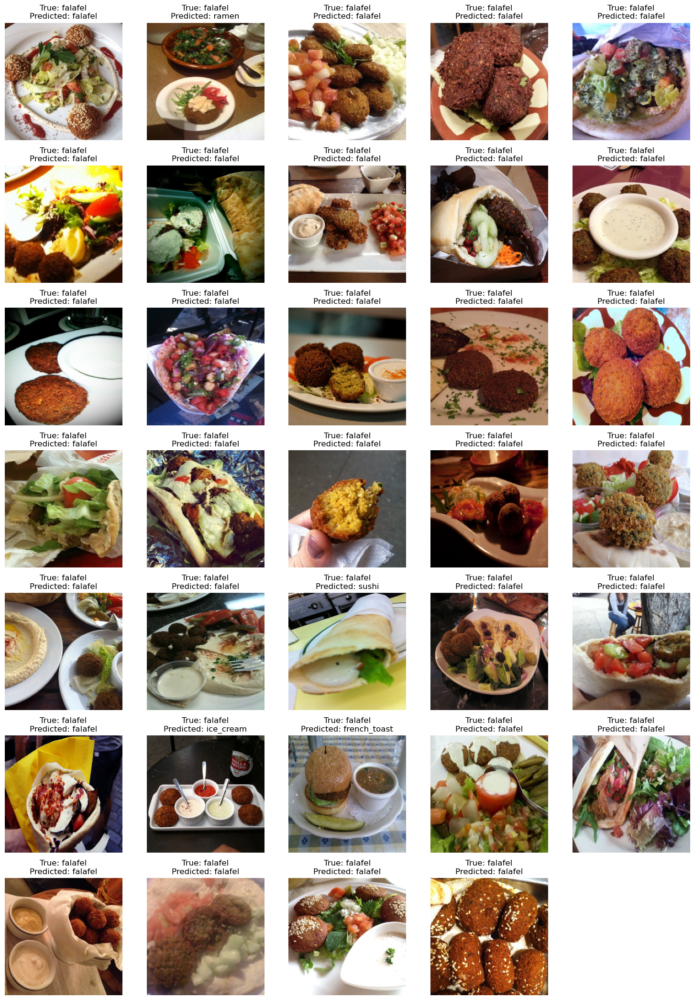

Class: french_toast
Number of images: 28


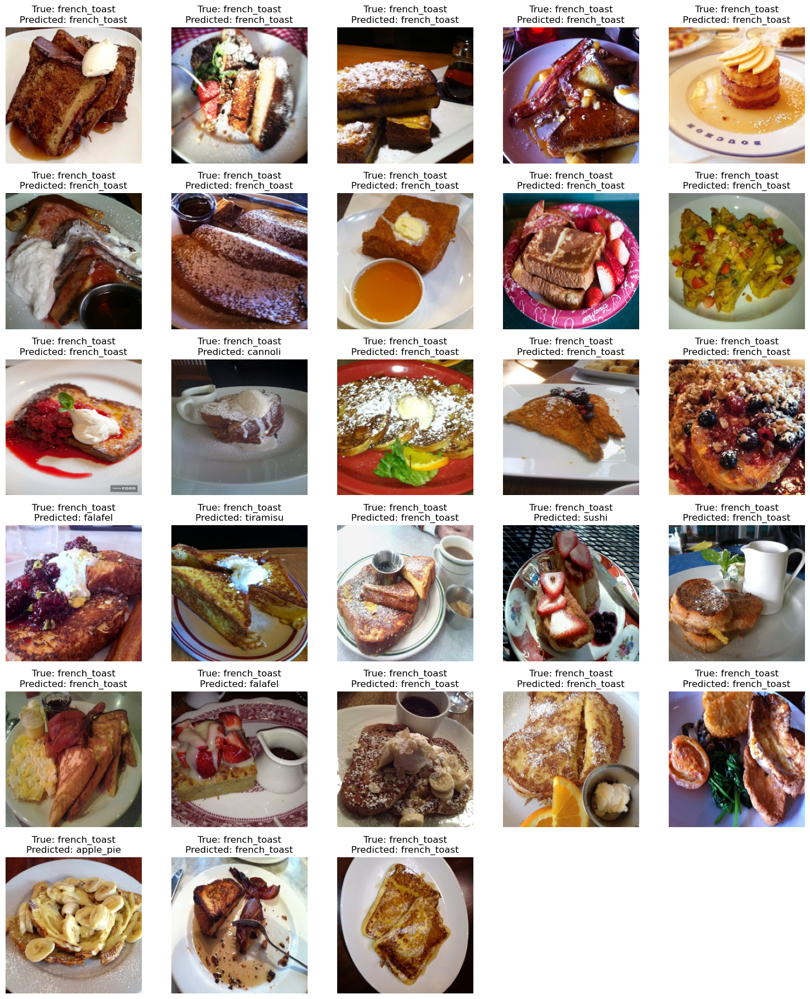

Class: ice_cream
Number of images: 28


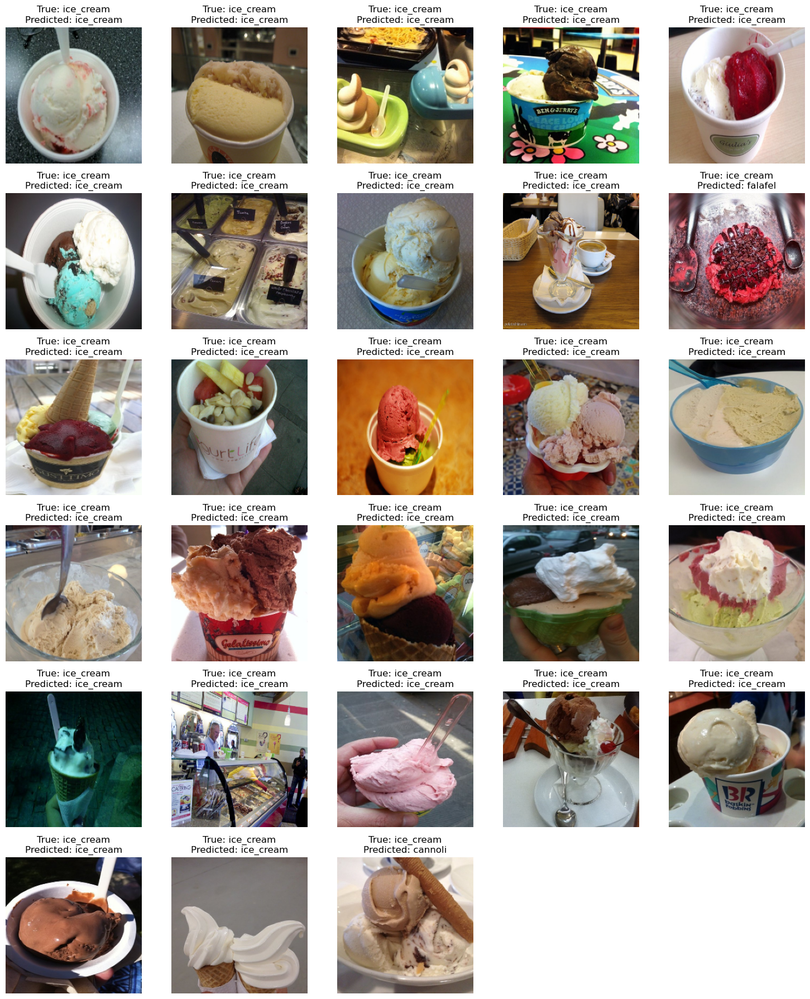

Class: ramen
Number of images: 26


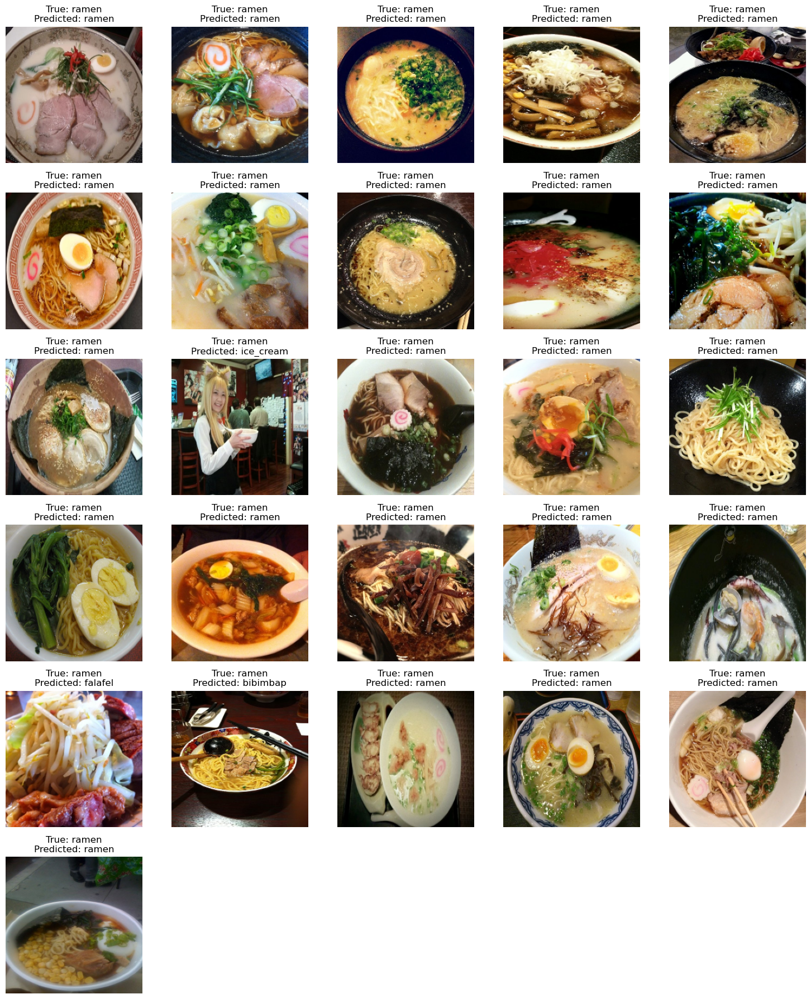

Class: sushi
Number of images: 38


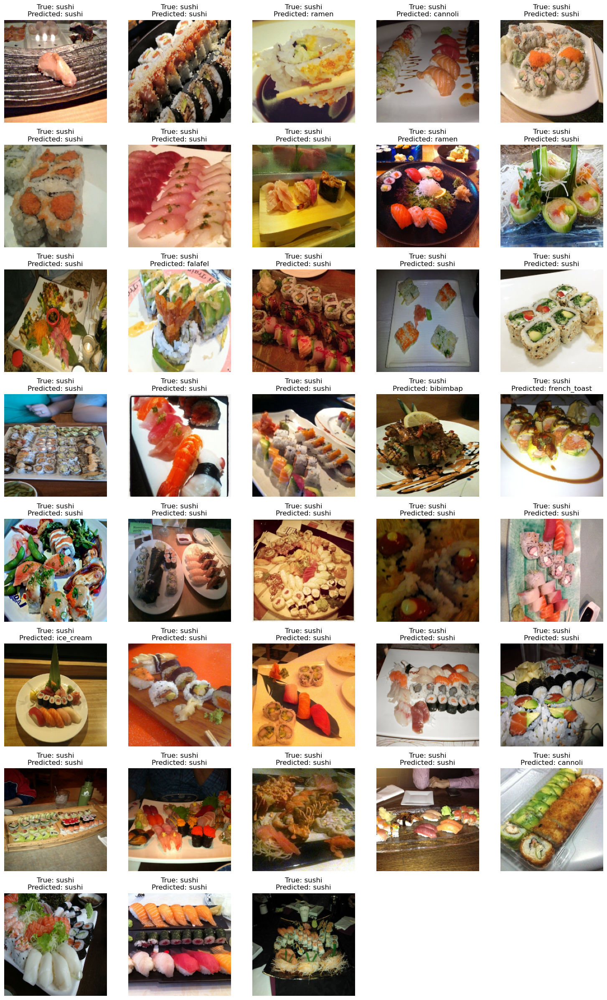

Class: tiramisu
Number of images: 25


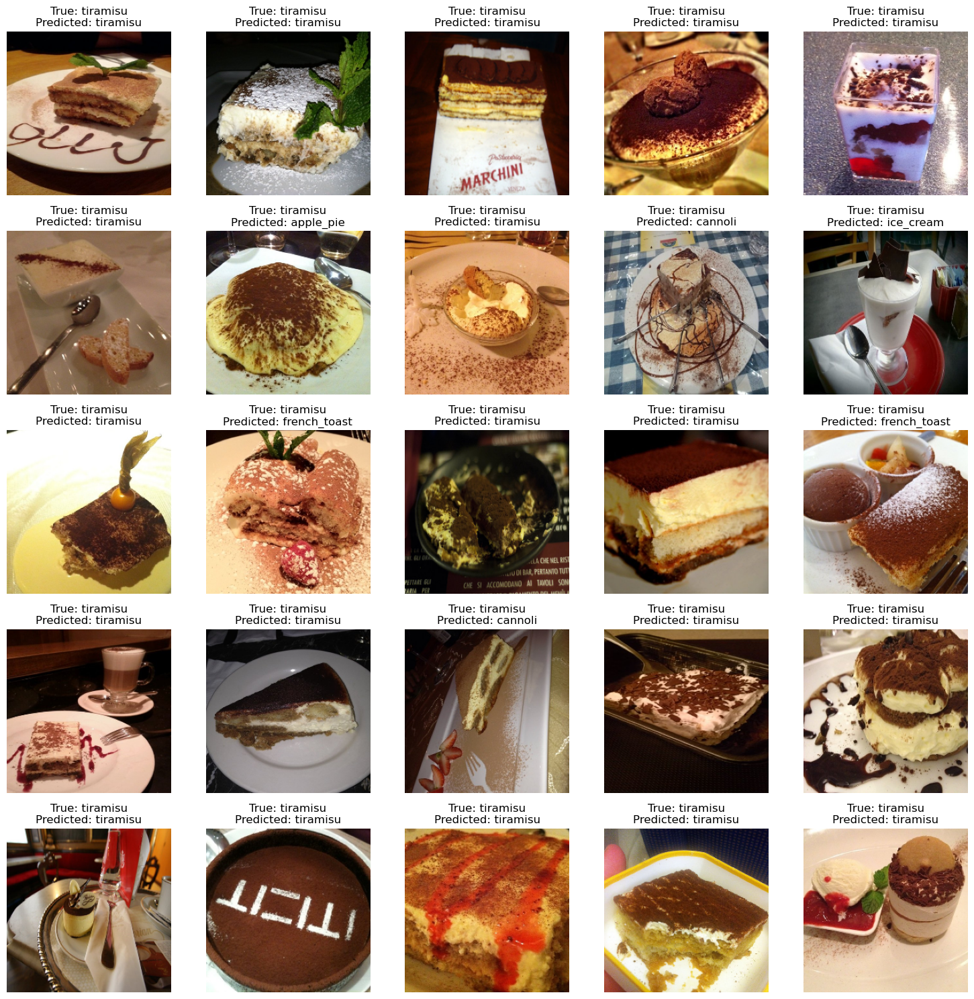

In [11]:
#importing libraries
import matplotlib.pyplot as plt
import math



# Function to visualize images for a specific class
def visualize_class_images(images, true_labels, predicted_labels, class_name, class_names):
    class_indices = [i for i, label in enumerate(true_labels) if label == class_name]
    class_images = [images[i] for i in class_indices]
    class_true_labels = [class_names[label] for label in true_labels[class_indices]]
    class_predicted_labels = [class_names[label] for label in predicted_labels[class_indices]]
    
    print(f"Class: {class_names[class_name]}")
    print(f"Number of images: {len(class_images)}")
    
    num_images = len(class_images)
    rows = math.ceil(num_images / 5)
    cols = min(num_images, 5)
    
    plt.figure(figsize=(15, 3 * rows))
    for i, (image, true_label, predicted_label) in enumerate(zip(class_images, class_true_labels, class_predicted_labels)):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(image)
        plt.title(f"True: {true_label}\nPredicted: {predicted_label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Define class names using the encoder
class_names = label_encoder.classes_

# Visualize images for each class
for class_index, class_name in enumerate(class_names):
    visualize_class_images(X_test, np.argmax(y_test, axis=1), y_pred_classes, class_index, class_names)


<Figure size 1000x800 with 0 Axes>

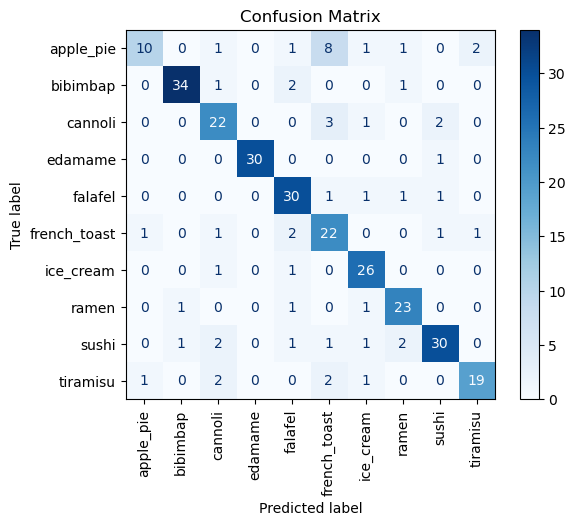

In [12]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

# Plot confusion matrix
plt.figure(figsize=(10, 8))
cm = confusion_matrix(np.argmax(y_test, axis=1), y_pred_classes)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_encoder.classes_)
disp.plot(cmap=plt.cm.Blues, xticks_rotation='vertical')
plt.title('Confusion Matrix')
plt.show()
